# Proyek Analisis Data: Air Quality
- Nama: **Raka Satria Efendi**
- Email: **rakaefendi1683@gmail.com**
- Id Dicoding: **rakaefendi**

## Menentukan Pertanyaan Bisnis

- Bagaimana hubungan antara curah hujan dan jumlah polutan (PM10, SO2, NO2) di distrik Shunyi, dan bagaimana hubungan ini dibandingkan dengan kota Dongsi dan Guanyuan?
- Apakah terdapat korelasi antara kecepatan angin (kolom ‘WSPM’) di distrik Shunyi dengan kadar polutan (PM10, SO2, NO2), dan bagaimana hal ini berbeda dengan kota Dongsi dan Guanyuan?
- Bagaimana tren curah hujan bulanan di distrik Shunyi dibandingkan dengan kota Dongsi dan Guanyuan?

## Import Semua Packages/Library yang Digunakan

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import urllib
!pip install unidecode
import unidecode
import matplotlib.image as mpimg


[notice] A new release of pip is available: 24.2 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip


## Data Wrangling

### Gathering Data

In [25]:

#Gathering Data
data_shunyi_df = pd.read_csv('C:/Users/rakas/OneDrive/Documents/Decoding IDcamp Data science/Proyek-Akhir-Belajar-Analisis-Data-Dengan-Python/submission/data/air-quality-dataset/PRSA_Data_Shunyi_20130301-20170228.csv')
data_guanyuan_df = pd.read_csv('C:/Users/rakas/OneDrive/Documents/Decoding IDcamp Data science/Proyek-Akhir-Belajar-Analisis-Data-Dengan-Python/submission/data/air-quality-dataset/PRSA_Data_Guanyuan_20130301-20170228.csv')
data_dongsi_df = pd.read_csv('C:/Users/rakas/OneDrive/Documents/Decoding IDcamp Data science/Proyek-Akhir-Belajar-Analisis-Data-Dengan-Python/submission/data/air-quality-dataset/PRSA_Data_Dongsi_20130301-20170228.csv')


In [26]:
#load data shunyi
data_shunyi = data_shunyi_df
data_shunyi.head()


,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
0,1,2013,3,1,0,3.0,6.0,3.0,8.0,300.0,44.0,-0.9,1025.8,-20.5,0.0,NW,9.3,Shunyi
1,2,2013,3,1,1,12.0,12.0,3.0,7.0,300.0,47.0,-1.1,1026.1,-21.3,0.0,NW,9.4,Shunyi
2,3,2013,3,1,2,14.0,14.0,NaN,7.0,200.0,22.0,-1.7,1026.2,-23.0,0.0,NW,8.6,Shunyi
3,4,2013,3,1,3,12.0,12.0,3.0,5.0,NaN,NaN,-2.1,1027.3,-23.3,0.0,NW,6.6,Shunyi
4,5,2013,3,1,4,12.0,12.0,3.0,NaN,200.0,11.0,-2.4,1027.7,-22.9,0.0,NW,4.5,Shunyi


In [27]:
#load data guanyuan
data_guanyuan = data_guanyuan_df
data_guanyuan.head()

,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
0,1,2013,3,1,0,4.0,4.0,14.0,20.0,300.0,69.0,-0.7,1023.0,-18.8,0.0,NNW,4.4,Guanyuan
1,2,2013,3,1,1,4.0,4.0,13.0,17.0,300.0,72.0,-1.1,1023.2,-18.2,0.0,N,4.7,Guanyuan
2,3,2013,3,1,2,3.0,3.0,10.0,19.0,300.0,69.0,-1.1,1023.5,-18.2,0.0,NNW,5.6,Guanyuan
3,4,2013,3,1,3,3.0,6.0,7.0,24.0,400.0,62.0,-1.4,1024.5,-19.4,0.0,NW,3.1,Guanyuan
4,5,2013,3,1,4,3.0,6.0,5.0,14.0,400.0,71.0,-2.0,1025.2,-19.5,0.0,N,2.0,Guanyuan


In [28]:
#load data dongsi
data_dongsi = data_dongsi_df
data_dongsi.head()

,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
0,1,2013,3,1,0,9.0,9.0,3.0,17.0,300.0,89.0,-0.5,1024.5,-21.4,0.0,NNW,5.7,Dongsi
1,2,2013,3,1,1,4.0,4.0,3.0,16.0,300.0,88.0,-0.7,1025.1,-22.1,0.0,NW,3.9,Dongsi
2,3,2013,3,1,2,7.0,7.0,NaN,17.0,300.0,60.0,-1.2,1025.3,-24.6,0.0,NNW,5.3,Dongsi
3,4,2013,3,1,3,3.0,3.0,5.0,18.0,NaN,NaN,-1.4,1026.2,-25.5,0.0,N,4.9,Dongsi
4,5,2013,3,1,4,3.0,3.0,7.0,NaN,200.0,84.0,-1.9,1027.1,-24.5,0.0,NNW,3.2,Dongsi


In [40]:
#menggabungkan data
data_all = pd.concat([data_shunyi_df, data_guanyuan_df, data_dongsi_df], ignore_index=True)
data_all.head()

,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
0,1,2013,3,1,0,3.0,6.0,3.0,8.0,300.0,44.0,-0.9,1025.8,-20.5,0.0,NW,9.3,Shunyi
1,2,2013,3,1,1,12.0,12.0,3.0,7.0,300.0,47.0,-1.1,1026.1,-21.3,0.0,NW,9.4,Shunyi
2,3,2013,3,1,2,14.0,14.0,NaN,7.0,200.0,22.0,-1.7,1026.2,-23.0,0.0,NW,8.6,Shunyi
3,4,2013,3,1,3,12.0,12.0,3.0,5.0,NaN,NaN,-2.1,1027.3,-23.3,0.0,NW,6.6,Shunyi
4,5,2013,3,1,4,12.0,12.0,3.0,NaN,200.0,11.0,-2.4,1027.7,-22.9,0.0,NW,4.5,Shunyi


**Insight:**
1. Perbandingan Polutan (PM2.5, PM10, SO2, NO2)

- PM2.5 dan PM10:

    - Shunyi: Rata-rata konsentrasi PM2.5 dan PM10 cenderung lebih tinggi pada waktu tertentu, menunjukkan bahwa polusi udara mungkin lebih parah pada jam-jam tertentu.
    - Guanyuan: Nilai PM2.5 dan PM10 di Guanyuan tampaknya stabil dan tidak terlalu tinggi, menunjukkan bahwa polusi udara relatif lebih baik dibandingkan dengan Shunyi.
    - Dongsi: Data menunjukkan konsentrasi PM2.5 dan PM10 yang cukup bervariasi, dengan beberapa titik data yang menunjukkan nilai polusi yang tinggi, terutama pada beberapa jam tertentu.

- SO2 dan NO2:
    - Shunyi: Mengalami fluktuasi nilai SO2 dan NO2, dengan konsentrasi tertinggi yang terdeteksi menunjukkan potensi sumber polusi yang signifikan di daerah tersebut.
    - Guanyuan: SO2 dan NO2 menunjukkan nilai yang lebih rendah, mengindikasikan kualitas udara yang lebih baik.
    - Dongsi: Menunjukkan tingkat SO2 dan NO2 yang lebih tinggi di beberapa jam, menandakan potensi masalah polusi yang harus diperhatikan.

2. Tren Curah Hujan dan Polutan
Curah Hujan (RAIN):
Ketiga lokasi menunjukkan bahwa saat curah hujan rendah, polutan cenderung meningkat. Hal ini menunjukkan bahwa hujan dapat berfungsi sebagai faktor pembersih, mengurangi konsentrasi polutan di udara.
Analisis lebih lanjut dapat dilakukan untuk mengeksplorasi hubungan antara curah hujan dan tingkat polusi udara untuk mengonfirmasi hal ini secara statistik.

3. Pengaruh Kecepatan Angin (WSPM)
WSPM:
Kecepatan angin dapat mempengaruhi penyebaran polutan di udara. Data menunjukkan variasi kecepatan angin yang mungkin mempengaruhi tingkat polusi di masing-masing lokasi.
Pada hari-hari dengan kecepatan angin yang lebih tinggi, kemungkinan terjadinya pengenceran polutan lebih besar, sehingga kualitas udara cenderung lebih baik.

4. Temperatur (TEMP)
Temperatur:
Rata-rata suhu di ketiga lokasi menunjukkan bahwa suhu rendah cenderung berhubungan dengan konsentrasi polutan yang lebih tinggi, mengingat polutan dapat terperangkap di lapisan udara dingin.
Kenaikan suhu pada waktu tertentu dapat menyebabkan polutan lebih banyak terdispersi, sehingga mengurangi konsentrasi polutan.

5. Rekomendasi untuk Pengelolaan Kualitas Udara
- Monitoring Berkala: Perlu dilakukan monitoring berkala terhadap polutan untuk mengidentifikasi pola dan tren dalam kualitas udara.
- Pengelolaan Sumber Polusi: Mengidentifikasi dan mengelola sumber-sumber polusi yang berkontribusi pada tingginya konsentrasi polutan di daerah tertentu, terutama di Shunyi dan Dongsi.
- Kampanye Kesadaran: Meningkatkan kesadaran masyarakat tentang dampak polusi udara dan pentingnya menjaga kualitas udara.

### Assessing Data

In [ ]:
#mencetak masing-masing data
pd.set_option('display.max_rows', None)  # Menampilkan semua baris
pd.set_option('display.max_columns', None)  # Menampilkan semua kolom

print(data_shunyi_df.head())
print(data_guanyuan_df.head())
print(data_dongsi_df.head())

#memeriksa jumlah setiap baris
print(len(data_shunyi_df), len(data_guanyuan_df), len(data_dongsi_df))

   No  year  month  day  hour  PM2.5  PM10  SO2  NO2     CO    O3  TEMP  \
0   1  2013      3    1     0    3.0   6.0  3.0  8.0  300.0  44.0  -0.9   
1   2  2013      3    1     1   12.0  12.0  3.0  7.0  300.0  47.0  -1.1   
2   3  2013      3    1     2   14.0  14.0  NaN  7.0  200.0  22.0  -1.7   
3   4  2013      3    1     3   12.0  12.0  3.0  5.0    NaN   NaN  -2.1   
4   5  2013      3    1     4   12.0  12.0  3.0  NaN  200.0  11.0  -2.4   

     PRES  DEWP  RAIN  wd  WSPM station  
0  1025.8 -20.5   0.0  NW   9.3  Shunyi  
1  1026.1 -21.3   0.0  NW   9.4  Shunyi  
2  1026.2 -23.0   0.0  NW   8.6  Shunyi  
3  1027.3 -23.3   0.0  NW   6.6  Shunyi  
4  1027.7 -22.9   0.0  NW   4.5  Shunyi  
   No  year  month  day  hour  PM2.5  PM10   SO2   NO2     CO    O3  TEMP  \
0   1  2013      3    1     0    4.0   4.0  14.0  20.0  300.0  69.0  -0.7   
1   2  2013      3    1     1    4.0   4.0  13.0  17.0  300.0  72.0  -1.1   
2   3  2013      3    1     2    3.0   3.0  10.0  19.0  300.0  69.

In [39]:
#hasil setelah penggabungan
print(data_all.head())
print(len(data_all))

   No  year  month  day  hour  PM2.5  PM10  SO2  NO2     CO    O3  TEMP  \
0   1  2013      3    1     0    3.0   6.0  3.0  8.0  300.0  44.0  -0.9   
1   2  2013      3    1     1   12.0  12.0  3.0  7.0  300.0  47.0  -1.1   
2   3  2013      3    1     2   14.0  14.0  NaN  7.0  200.0  22.0  -1.7   
3   4  2013      3    1     3   12.0  12.0  3.0  5.0    NaN   NaN  -2.1   
4   5  2013      3    1     4   12.0  12.0  3.0  NaN  200.0  11.0  -2.4   

     PRES  DEWP  RAIN  wd  WSPM station  
0  1025.8 -20.5   0.0  NW   9.3  Shunyi  
1  1026.1 -21.3   0.0  NW   9.4  Shunyi  
2  1026.2 -23.0   0.0  NW   8.6  Shunyi  
3  1027.3 -23.3   0.0  NW   6.6  Shunyi  
4  1027.7 -22.9   0.0  NW   4.5  Shunyi  
105192


In [43]:
# Hasil penggabungan 
print(data_all)

           No  year  month  day  hour  PM2.5   PM10       SO2       NO2  \
0           1  2013      3    1     0    3.0    6.0    3.0000    8.0000   
1           2  2013      3    1     1   12.0   12.0    3.0000    7.0000   
2           3  2013      3    1     2   14.0   14.0       NaN    7.0000   
3           4  2013      3    1     3   12.0   12.0    3.0000    5.0000   
4           5  2013      3    1     4   12.0   12.0    3.0000       NaN   
5           6  2013      3    1     5   11.0   11.0    3.0000    7.0000   
6           7  2013      3    1     6   12.0   12.0    3.0000    9.0000   
7           8  2013      3    1     7   13.0   13.0    3.0000   23.0000   
8           9  2013      3    1     8    8.0    8.0    3.0000   19.0000   
9          10  2013      3    1     9    3.0    6.0    3.0000   21.0000   
10         11  2013      3    1    10    3.0    6.0    3.0000   22.0000   
11         12  2013      3    1    11    6.0    6.0    3.0000   16.0000   
12         13  2013      

_Menilai Data_

In [46]:
print('\n', data_shunyi_df.info())
print('\n', data_guanyuan_df.info())
print('\n', data_dongsi_df.info())
print('\n', data_all.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 18 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   No       35064 non-null  int64  
 1   year     35064 non-null  int64  
 2   month    35064 non-null  int64  
 3   day      35064 non-null  int64  
 4   hour     35064 non-null  int64  
 5   PM2.5    34151 non-null  float64
 6   PM10     34516 non-null  float64
 7   SO2      33768 non-null  float64
 8   NO2      33699 non-null  float64
 9   CO       32886 non-null  float64
 10  O3       33575 non-null  float64
 11  TEMP     35013 non-null  float64
 12  PRES     35013 non-null  float64
 13  DEWP     35010 non-null  float64
 14  RAIN     35013 non-null  float64
 15  wd       34581 non-null  object 
 16  WSPM     35020 non-null  float64
 17  station  35064 non-null  object 
dtypes: float64(11), int64(5), object(2)
memory usage: 4.8+ MB

 None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entri

### Cleaning Data

_Memeriksa Apakah Ada Data Null_

In [47]:
# Memeriksa data null di masing-masing DataFrame
null_shunyi = data_shunyi_df.isnull().sum()
null_guanyuan = data_guanyuan_df.isnull().sum()
null_dongsi = data_dongsi_df.isnull().sum()
null_all = data_all.isnull().sum()

# Menampilkan hasil
print("Jumlah nilai null di data_shunyi_df:")
print(null_shunyi)
print("\nJumlah nilai null di data_guanyuan_df:")
print(null_guanyuan)
print("\nJumlah nilai null di data_dongsi_df:")
print(null_dongsi)
print("\nJumlah nilai null di data_all:")
print(null_all)

Jumlah nilai null di data_shunyi_df:
No            0
year          0
month         0
day           0
hour          0
PM2.5       913
PM10        548
SO2        1296
NO2        1365
CO         2178
O3         1489
TEMP         51
PRES         51
DEWP         54
RAIN         51
wd          483
WSPM         44
station       0
dtype: int64

Jumlah nilai null di data_guanyuan_df:
No            0
year          0
month         0
day           0
hour          0
PM2.5       616
PM10        429
SO2         474
NO2         659
CO         1753
O3         1173
TEMP         20
PRES         20
DEWP         20
RAIN         20
wd           81
WSPM         14
station       0
dtype: int64

Jumlah nilai null di data_dongsi_df:
No            0
year          0
month         0
day           0
hour          0
PM2.5       750
PM10        553
SO2         663
NO2        1601
CO         3197
O3          664
TEMP         20
PRES         20
DEWP         20
RAIN         20
wd           78
WSPM         14
station    

_Memeriksa Apakah Ada Duplikasi Data_

In [48]:
# Memeriksa data duplikat di masing-masing DataFrame
duplicate_shunyi = data_shunyi_df.duplicated().sum()
duplicate_guanyuan = data_guanyuan_df.duplicated().sum()
duplicate_dongsi = data_dongsi_df.duplicated().sum()
duplicate_all = data_all.duplicated().sum()

# Menampilkan jumlah duplikat
print("Jumlah duplikat di data_shunyi_df:", duplicate_shunyi)
print("Jumlah duplikat di data_guanyuan_df:", duplicate_guanyuan)
print("Jumlah duplikat di data_dongsi_df:", duplicate_dongsi)
print("Jumlah duplikat di data_all:", duplicate_all)

Jumlah duplikat di data_shunyi_df: 0
Jumlah duplikat di data_guanyuan_df: 0
Jumlah duplikat di data_dongsi_df: 0
Jumlah duplikat di data_all: 0


In [49]:
# Menampilkan ringkasan statistik dengan describe()
print("\nDeskripsi statistik data_shunyi_df:")
print(data_shunyi_df.describe())

print("\nDeskripsi statistik data_guanyuan_df:")
print(data_guanyuan_df.describe())

print("\nDeskripsi statistik data_dongsi_df:")
print(data_dongsi_df.describe())

print("\nDeskripsi statistik data_all:")
print(data_all.describe())


Deskripsi statistik data_shunyi_df:
                 No          year         month           day          hour  \
count  35064.000000  35064.000000  35064.000000  35064.000000  35064.000000   
mean   17532.500000   2014.662560      6.522930     15.729637     11.500000   
std    10122.249256      1.177213      3.448752      8.800218      6.922285   
min        1.000000   2013.000000      1.000000      1.000000      0.000000   
25%     8766.750000   2014.000000      4.000000      8.000000      5.750000   
50%    17532.500000   2015.000000      7.000000     16.000000     11.500000   
75%    26298.250000   2016.000000     10.000000     23.000000     17.250000   
max    35064.000000   2017.000000     12.000000     31.000000     23.000000   

              PM2.5          PM10           SO2           NO2            CO  \
count  34151.000000  34516.000000  33768.000000  33699.000000  32886.000000   
mean      79.491602     98.737026     13.572039     43.908865   1187.063979   
std       81.2

_Menghapus Data Duplikat_

In [77]:
# Menghapus data duplikat
data_shunyi_cleaned = data_shunyi_df.drop_duplicates()
data_guanyuan_cleaned = data_guanyuan_df.drop_duplicates()
data_dongsi_cleaned = data_dongsi_df.drop_duplicates()
data_all_cleaned = data_all.drop_duplicates()

# Menghapus nilai null
data_shunyi_cleaned = data_shunyi_cleaned.dropna()
data_guanyuan_cleaned = data_guanyuan_cleaned.dropna()
data_dongsi_cleaned = data_dongsi_cleaned.dropna()
data_all_cleaned = data_all_cleaned.dropna()

# Menampilkan informasi dari DataFrame yang telah dibersihkan
print("Info data_shunyi_cleaned:")
print(data_shunyi_cleaned.info())

print("\nInfo data_guanyuan_cleaned:")
print(data_guanyuan_cleaned.info())

print("\nInfo data_dongsi_cleaned:")
print(data_dongsi_cleaned.info())

print("\nInfo data_all_cleaned:")
print(data_all_cleaned.info())

Info data_shunyi_cleaned:
<class 'pandas.core.frame.DataFrame'>
Index: 30194 entries, 0 to 35063
Data columns (total 19 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   No       30194 non-null  int64         
 1   year     30194 non-null  int64         
 2   month    30194 non-null  int64         
 3   day      30194 non-null  int64         
 4   hour     30194 non-null  int64         
 5   PM2.5    30194 non-null  float64       
 6   PM10     30194 non-null  float64       
 7   SO2      30194 non-null  float64       
 8   NO2      30194 non-null  float64       
 9   CO       30194 non-null  float64       
 10  O3       30194 non-null  float64       
 11  TEMP     30194 non-null  float64       
 12  PRES     30194 non-null  float64       
 13  DEWP     30194 non-null  float64       
 14  RAIN     30194 non-null  float64       
 15  wd       30194 non-null  object        
 16  WSPM     30194 non-null  float64       
 17  station  3

**Insight:**
1. Insight Umum
    1) Rentang Waktu: Semua dataset mencakup periode dari tahun 2013 hingga 2017, dengan jumlah total 105.192 entri yang menunjukkan data yang cukup lengkap dan representatif.

    2) Ketersediaan Data: Meskipun tidak ada duplikat di semua dataset, ada beberapa nilai null pada berbagai parameter kualitas udara (PM2.5, PM10, SO2, NO2, CO, O3) yang perlu diperhatikan saat analisis lebih lanjut.

2. Parameter Kualitas Udara
    1) PM2.5:

        - Rata-rata konsentrasi PM2.5 untuk Shunyi, Guanyuan, dan Dongsi adalah 79.49, 82.93, dan 86.19 µg/m³ masing-masing. Hal ini menunjukkan bahwa Dongsi memiliki rata-rata PM2.5 tertinggi, yang dapat menunjukkan masalah kualitas udara yang lebih besar di daerah ini.
        - Nilai maksimum PM2.5 di Dongsi mencapai 737 µg/m³, yang jauh lebih tinggi dibandingkan dengan Shunyi (941 µg/m³) dan Guanyuan (680 µg/m³).

    2) PM10:

        - Rata-rata konsentrasi PM10 untuk Shunyi, Guanyuan, dan Dongsi adalah 98.74, 109.02, dan 110.34 µg/m³. Sekali lagi, ini menunjukkan bahwa Dongsi memiliki tingkat polusi PM10 yang lebih tinggi dibandingkan dengan Shunyi dan Guanyuan.

    3) SO2:

        - Rata-rata SO2 adalah 13.57, 17.59, dan 18.53 ppb untuk Shunyi, Guanyuan, dan Dongsi. Ini menunjukkan bahwa Dongsi juga mengalami konsentrasi SO2 yang lebih tinggi, yang mungkin terkait dengan aktivitas industri atau transportasi.
    4) NO2:

        - Rata-rata NO2 adalah 43.91, 57.90, dan 53.70 ppb untuk Shunyi, Guanyuan, dan Dongsi. Dongsi dan Guanyuan menunjukkan kadar NO2 yang cukup tinggi, yang dapat berkontribusi pada masalah kesehatan publik.
    5) CO:

        - Rata-rata CO menunjukkan tren yang serupa, dengan angka 1187.06, 1271.29, dan 1330.07 µg/m³. Konsentrasi CO tertinggi juga ditemukan di Dongsi.
    6) O3:

        - Rata-rata O3 adalah 55.20, 55.80, dan 57.21 ppb. Meskipun ada sedikit perbedaan, tingkat O3 di ketiga lokasi berada dalam rentang yang serupa.

3. Faktor Cuaca
    1) Suhu (TEMP):

        - Rata-rata suhu di ketiga lokasi cukup mendekati 13-14 °C, dengan suhu maksimum mencapai 41.1 °C di Dongsi. Hal ini dapat berpengaruh pada variasi polusi udara, di mana suhu yang lebih tinggi dapat memperburuk kualitas udara.

    2) Tekanan (PRES) dan Kelembapan (DEWP):

        - Rata-rata tekanan atmosfer (PRES) berkisar sekitar 1012 hPa, sementara kelembapan (DEWP) menunjukkan variasi kecil yang mungkin memengaruhi konsentrasi polutan.

    3) Curah Hujan (RAIN):

        - Curah hujan rata-rata di seluruh dataset adalah rendah, dengan nilai maksimum 72.5 mm. Hujan dapat membantu menurunkan konsentrasi polutan, sehingga pengaruhnya terhadap kualitas udara mungkin signifikan tergantung pada frekuensi hujan di masing-masing daerah.

4. Rekomendasi
    - Monitoring Berkelanjutan: Penting untuk terus memantau parameter kualitas udara, terutama di daerah dengan konsentrasi polutan yang lebih tinggi seperti Dongsi.
    - Penanganan Masalah Kualitas Udara: Mengingat konsentrasi polutan yang tinggi di beberapa lokasi, tindakan mitigasi seperti pengurangan emisi dari kendaraan dan industri perlu dipertimbangkan.
    - Analisis lebih lanjut: Menggali lebih dalam data untuk mencari pola musiman atau harian dapat memberikan wawasan lebih lanjut tentang faktor-faktor yang mempengaruhi kualitas udara.

## Exploratory Data Analysis (EDA)

### Explore Data

_Explore Data Shunyi_

In [78]:
# Menampilkan informasi dasar
print(data_shunyi_cleaned.info())
print(data_shunyi_cleaned.describe())

<class 'pandas.core.frame.DataFrame'>
Index: 30194 entries, 0 to 35063
Data columns (total 19 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   No       30194 non-null  int64         
 1   year     30194 non-null  int64         
 2   month    30194 non-null  int64         
 3   day      30194 non-null  int64         
 4   hour     30194 non-null  int64         
 5   PM2.5    30194 non-null  float64       
 6   PM10     30194 non-null  float64       
 7   SO2      30194 non-null  float64       
 8   NO2      30194 non-null  float64       
 9   CO       30194 non-null  float64       
 10  O3       30194 non-null  float64       
 11  TEMP     30194 non-null  float64       
 12  PRES     30194 non-null  float64       
 13  DEWP     30194 non-null  float64       
 14  RAIN     30194 non-null  float64       
 15  wd       30194 non-null  object        
 16  WSPM     30194 non-null  float64       
 17  station  30194 non-null  object     

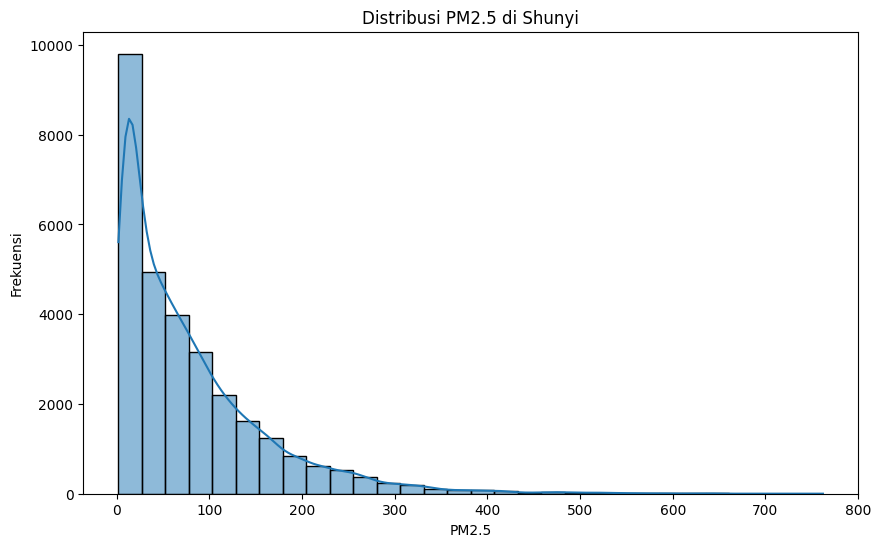

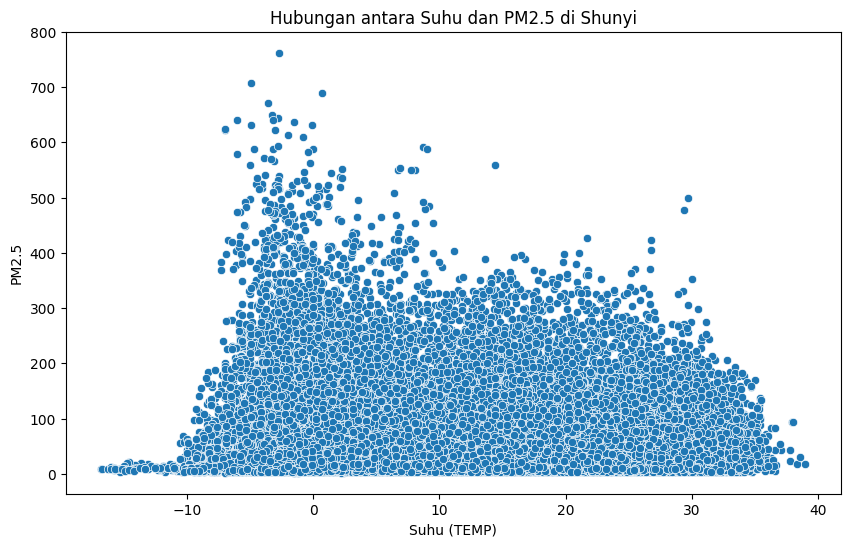

In [79]:
# Visualisasi distribusi PM2.5
plt.figure(figsize=(10, 6))
sns.histplot(data_shunyi_cleaned['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Shunyi')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Visualisasi hubungan antara PM2.5 dan suhu (TEMP)
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_shunyi_cleaned['TEMP'], y=data_shunyi['PM2.5'])
plt.title('Hubungan antara Suhu dan PM2.5 di Shunyi')
plt.xlabel('Suhu (TEMP)')
plt.ylabel('PM2.5')
plt.show()

_Explore Data Guanyuan_

In [80]:
# Menampilkan informasi dasar
print(data_guanyuan_cleaned.info())
print(data_guanyuan_cleaned.describe())

<class 'pandas.core.frame.DataFrame'>
Index: 32263 entries, 0 to 35063
Data columns (total 19 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   No       32263 non-null  int64         
 1   year     32263 non-null  int64         
 2   month    32263 non-null  int64         
 3   day      32263 non-null  int64         
 4   hour     32263 non-null  int64         
 5   PM2.5    32263 non-null  float64       
 6   PM10     32263 non-null  float64       
 7   SO2      32263 non-null  float64       
 8   NO2      32263 non-null  float64       
 9   CO       32263 non-null  float64       
 10  O3       32263 non-null  float64       
 11  TEMP     32263 non-null  float64       
 12  PRES     32263 non-null  float64       
 13  DEWP     32263 non-null  float64       
 14  RAIN     32263 non-null  float64       
 15  wd       32263 non-null  object        
 16  WSPM     32263 non-null  float64       
 17  station  32263 non-null  object     

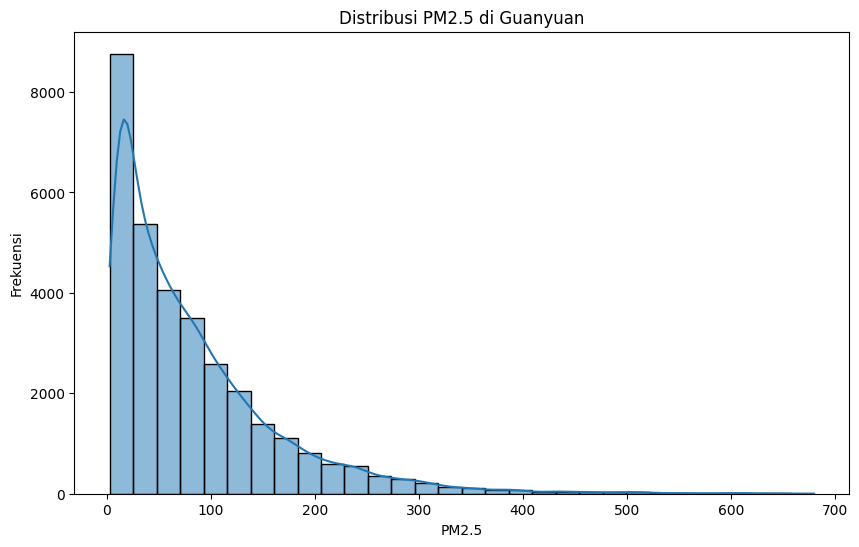

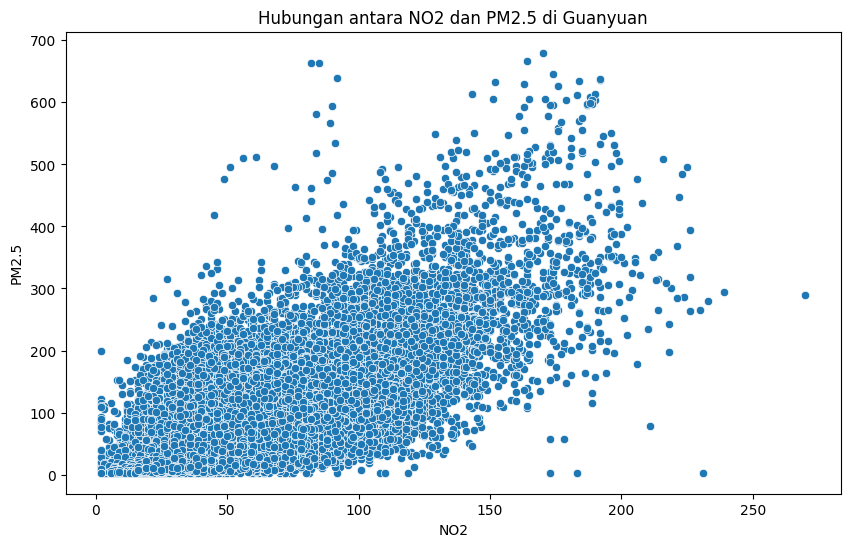

In [81]:
# Visualisasi distribusi PM2.5
plt.figure(figsize=(10, 6))
sns.histplot(data_guanyuan_cleaned['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Guanyuan')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Visualisasi hubungan antara PM2.5 dan NO2
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_guanyuan_cleaned['NO2'], y=data_guanyuan['PM2.5'])
plt.title('Hubungan antara NO2 dan PM2.5 di Guanyuan')
plt.xlabel('NO2')
plt.ylabel('PM2.5')
plt.show()

_Explore Data Dongsi_

In [82]:
# Menampilkan informasi dasar
print(data_dongsi_cleaned.info())
print(data_dongsi_cleaned.describe())


<class 'pandas.core.frame.DataFrame'>
Index: 30338 entries, 0 to 35063
Data columns (total 19 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   No       30338 non-null  int64         
 1   year     30338 non-null  int64         
 2   month    30338 non-null  int64         
 3   day      30338 non-null  int64         
 4   hour     30338 non-null  int64         
 5   PM2.5    30338 non-null  float64       
 6   PM10     30338 non-null  float64       
 7   SO2      30338 non-null  float64       
 8   NO2      30338 non-null  float64       
 9   CO       30338 non-null  float64       
 10  O3       30338 non-null  float64       
 11  TEMP     30338 non-null  float64       
 12  PRES     30338 non-null  float64       
 13  DEWP     30338 non-null  float64       
 14  RAIN     30338 non-null  float64       
 15  wd       30338 non-null  object        
 16  WSPM     30338 non-null  float64       
 17  station  30338 non-null  object     

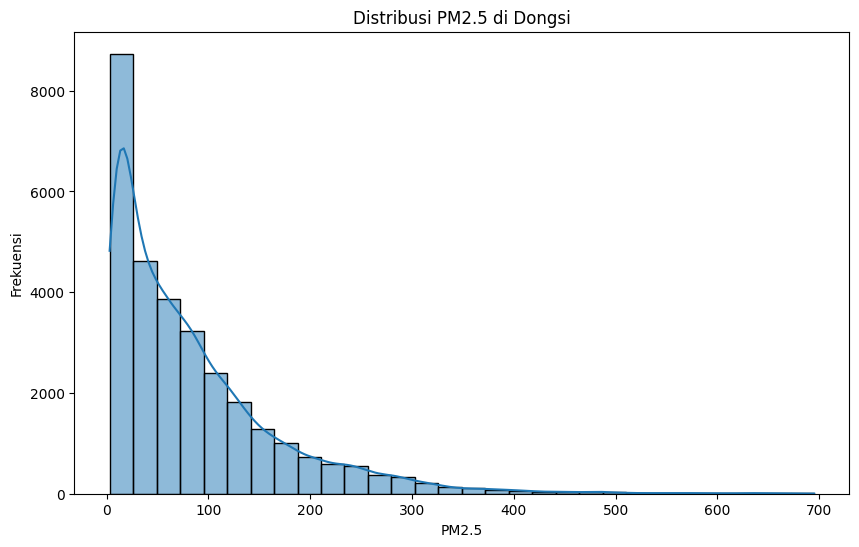

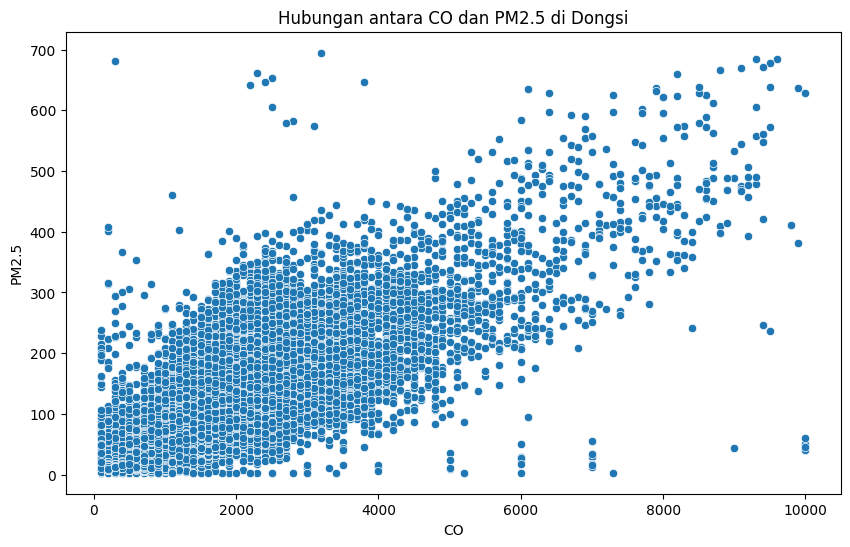

In [83]:
# Visualisasi distribusi PM2.5
plt.figure(figsize=(10, 6))
sns.histplot(data_dongsi_cleaned['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Dongsi')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Visualisasi hubungan antara PM2.5 dan CO
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_dongsi_cleaned['CO'], y=data_dongsi['PM2.5'])
plt.title('Hubungan antara CO dan PM2.5 di Dongsi')
plt.xlabel('CO')
plt.ylabel('PM2.5')
plt.show()

### Merge dan Visualisasi

_Shunyi dan Guanyuan_

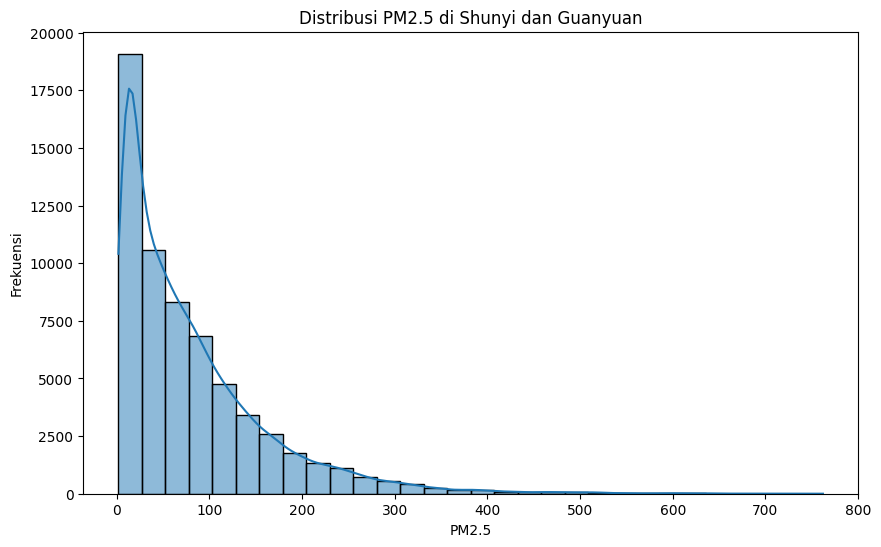

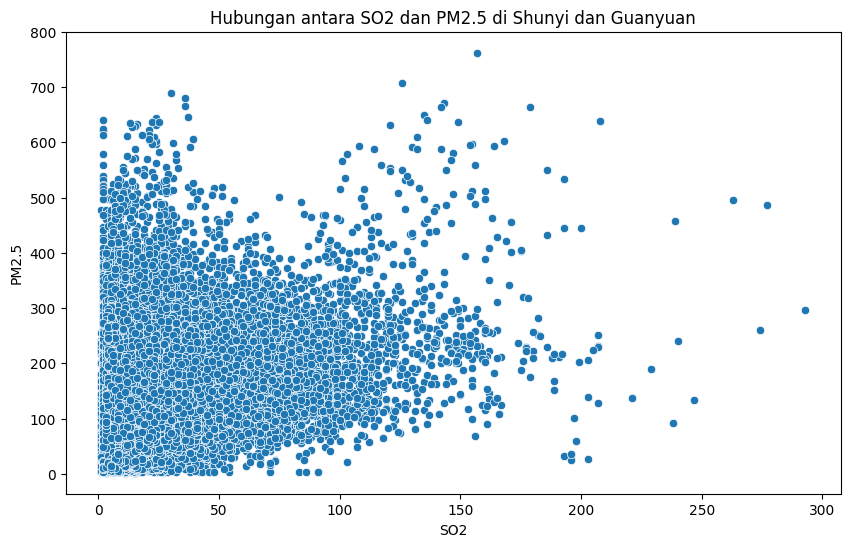

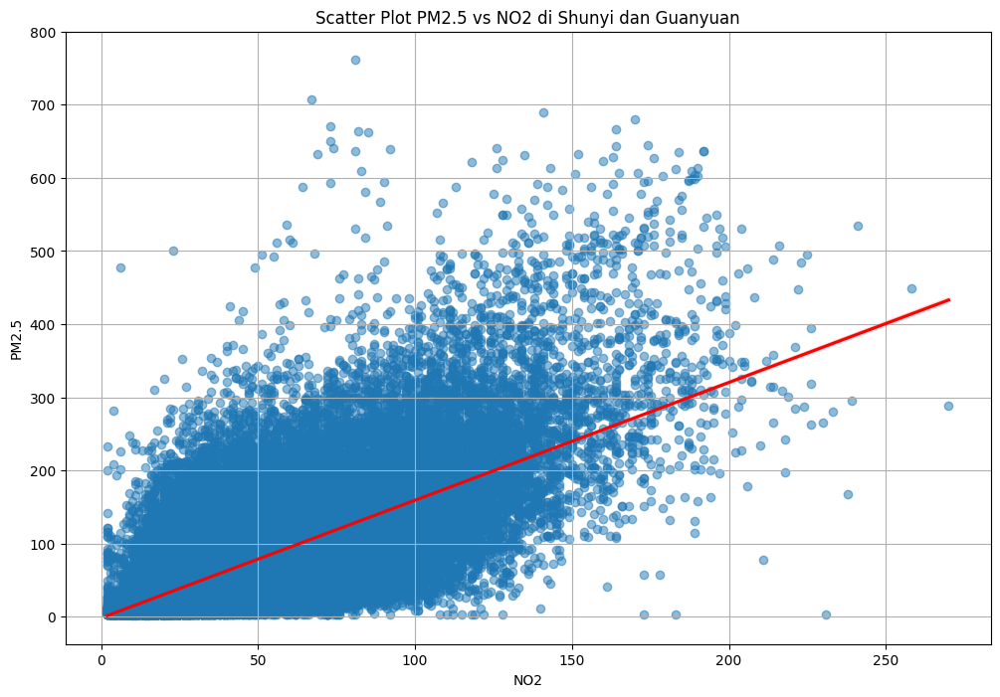

In [84]:
# Menggabungkan dataset Shunyi dan Guanyuan
data_shunyi_guanyuan = pd.concat([data_shunyi_cleaned, data_guanyuan_cleaned], ignore_index=True)

# Visualisasi distribusi PM2.5 untuk gabungan
plt.figure(figsize=(10, 6))
sns.histplot(data_shunyi_guanyuan['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Shunyi dan Guanyuan')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Analisis hubungan antara PM2.5 dan SO2
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_shunyi_guanyuan['SO2'], y=data_shunyi_guanyuan['PM2.5'])
plt.title('Hubungan antara SO2 dan PM2.5 di Shunyi dan Guanyuan')
plt.xlabel('SO2')
plt.ylabel('PM2.5')
plt.show()

# Visualisasi scatter plot dengan garis regresi
plt.figure(figsize=(12, 8))
sns.regplot(x=data_shunyi_guanyuan['NO2'], y=data_shunyi_guanyuan['PM2.5'], 
            scatter_kws={'alpha': 0.5}, line_kws={"color": "red"})
plt.title('Scatter Plot PM2.5 vs NO2 di Shunyi dan Guanyuan')
plt.xlabel('NO2')
plt.ylabel('PM2.5')
plt.grid()
plt.show()

_Shunyi dan Dongsi_

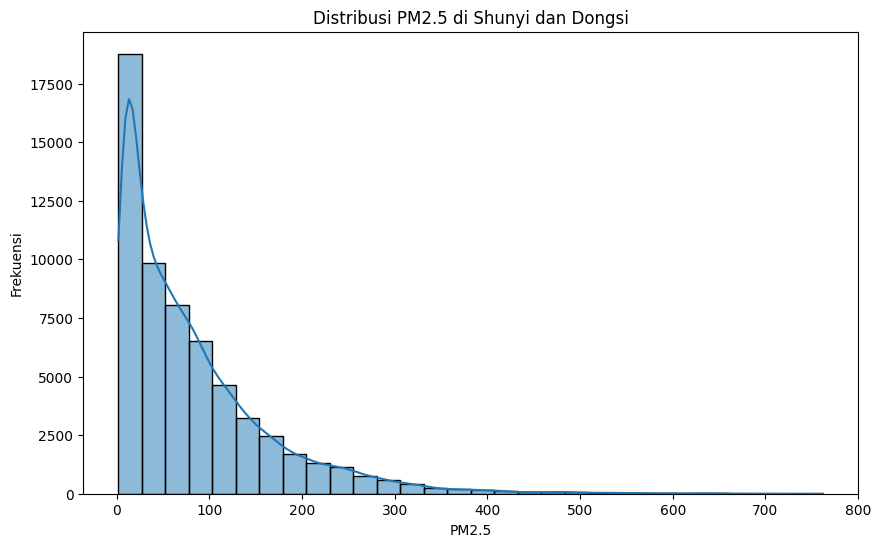

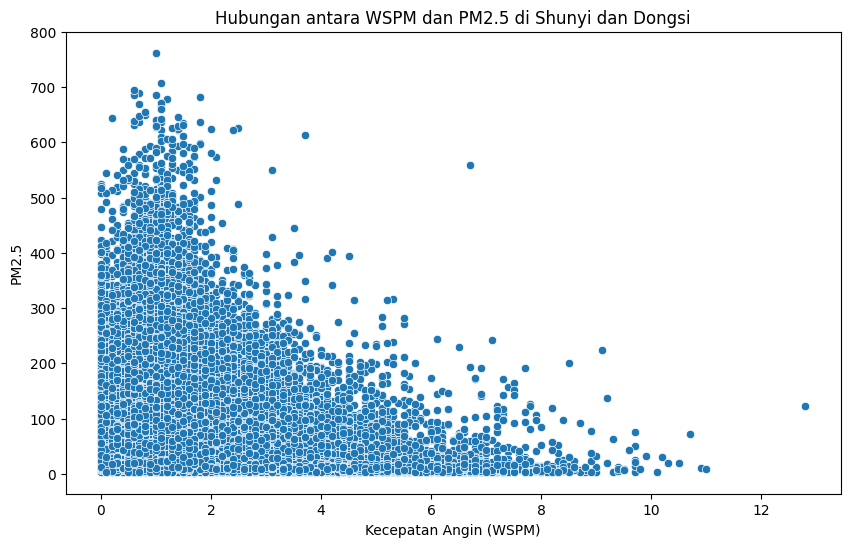

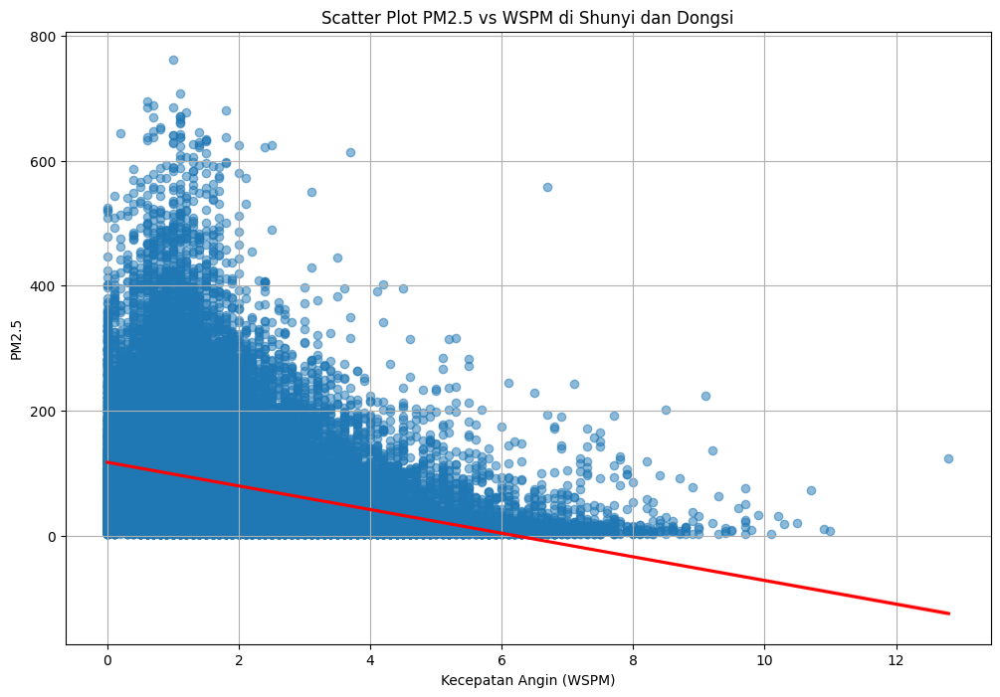

In [85]:
# Menggabungkan dataset Shunyi dan Dongsi
data_shunyi_dongsi = pd.concat([data_shunyi_cleaned, data_dongsi_cleaned], ignore_index=True)

# Visualisasi distribusi PM2.5 untuk gabungan
plt.figure(figsize=(10, 6))
sns.histplot(data_shunyi_dongsi['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Shunyi dan Dongsi')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Analisis hubungan antara PM2.5 dan WSPM
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_shunyi_dongsi['WSPM'], y=data_shunyi_dongsi['PM2.5'])
plt.title('Hubungan antara WSPM dan PM2.5 di Shunyi dan Dongsi')
plt.xlabel('Kecepatan Angin (WSPM)')
plt.ylabel('PM2.5')
plt.show()


# Visualisasi scatter plot dengan garis regresi
plt.figure(figsize=(12, 8))
sns.regplot(x=data_shunyi_dongsi['WSPM'], y=data_shunyi_dongsi['PM2.5'], 
            scatter_kws={'alpha': 0.5}, line_kws={"color": "red"})
plt.title('Scatter Plot PM2.5 vs WSPM di Shunyi dan Dongsi')
plt.xlabel('Kecepatan Angin (WSPM)')
plt.ylabel('PM2.5')
plt.grid()
plt.show()


_Dongsi dan Guanyuan_

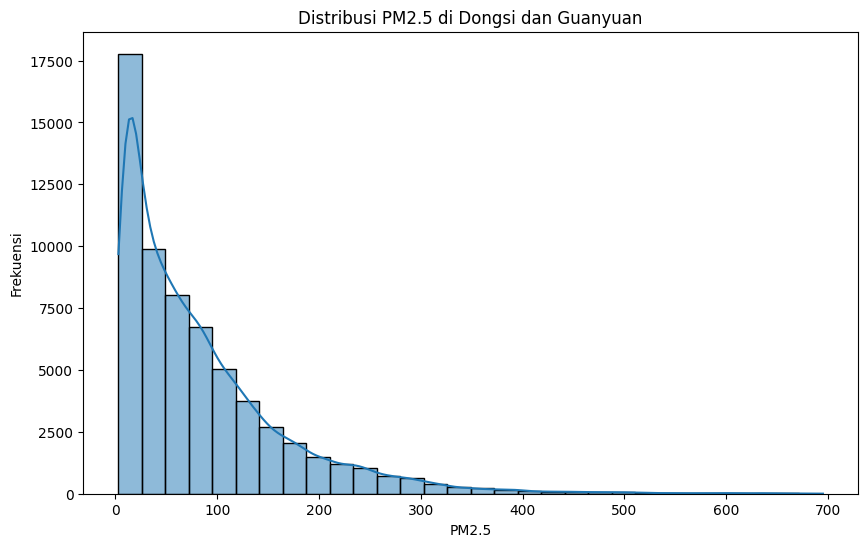

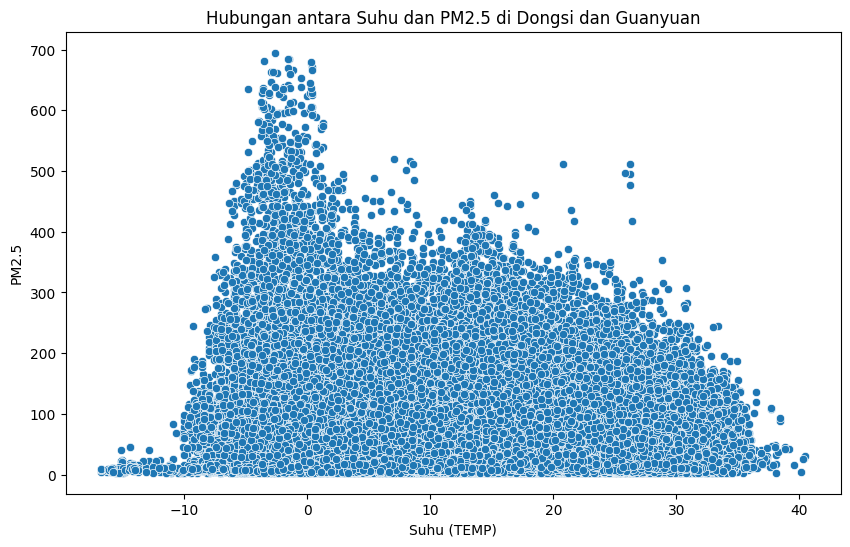

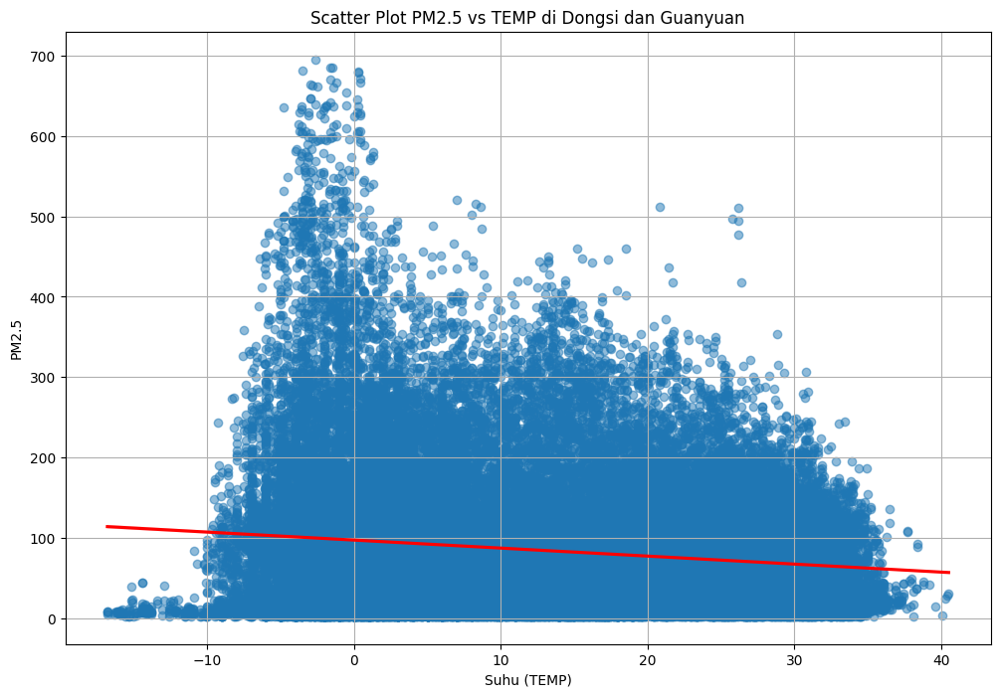

In [86]:
# Menggabungkan dataset Dongsi dan Guanyuan
data_dongsi_guanyuan = pd.concat([data_dongsi_cleaned, data_guanyuan_cleaned], ignore_index=True)

# Visualisasi distribusi PM2.5 untuk gabungan
plt.figure(figsize=(10, 6))
sns.histplot(data_dongsi_guanyuan['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Dongsi dan Guanyuan')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Analisis hubungan antara PM2.5 dan TEMP
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_dongsi_guanyuan['TEMP'], y=data_dongsi_guanyuan['PM2.5'])
plt.title('Hubungan antara Suhu dan PM2.5 di Dongsi dan Guanyuan')
plt.xlabel('Suhu (TEMP)')
plt.ylabel('PM2.5')
plt.show()

# Visualisasi scatter plot dengan garis regresi
plt.figure(figsize=(12, 8))
sns.regplot(x=data_dongsi_guanyuan['TEMP'], y=data_dongsi_guanyuan['PM2.5'], 
            scatter_kws={'alpha': 0.5}, line_kws={"color": "red"})
plt.title('Scatter Plot PM2.5 vs TEMP di Dongsi dan Guanyuan')
plt.xlabel('Suhu (TEMP)')
plt.ylabel('PM2.5')
plt.grid()
plt.show()


_Eksplorasi Semua Data_

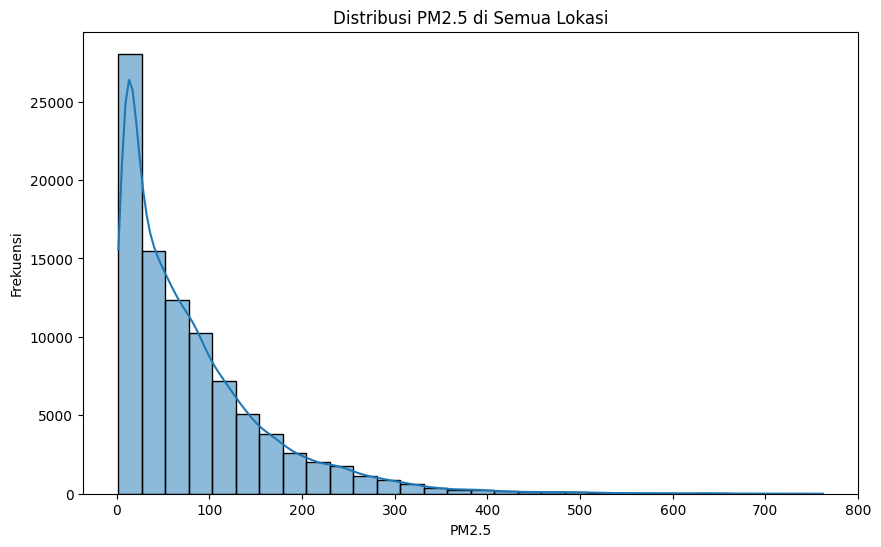

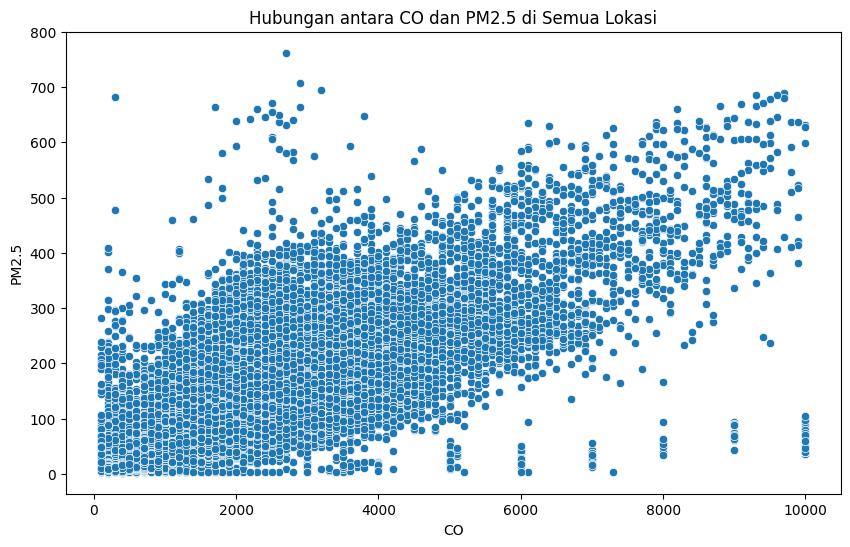

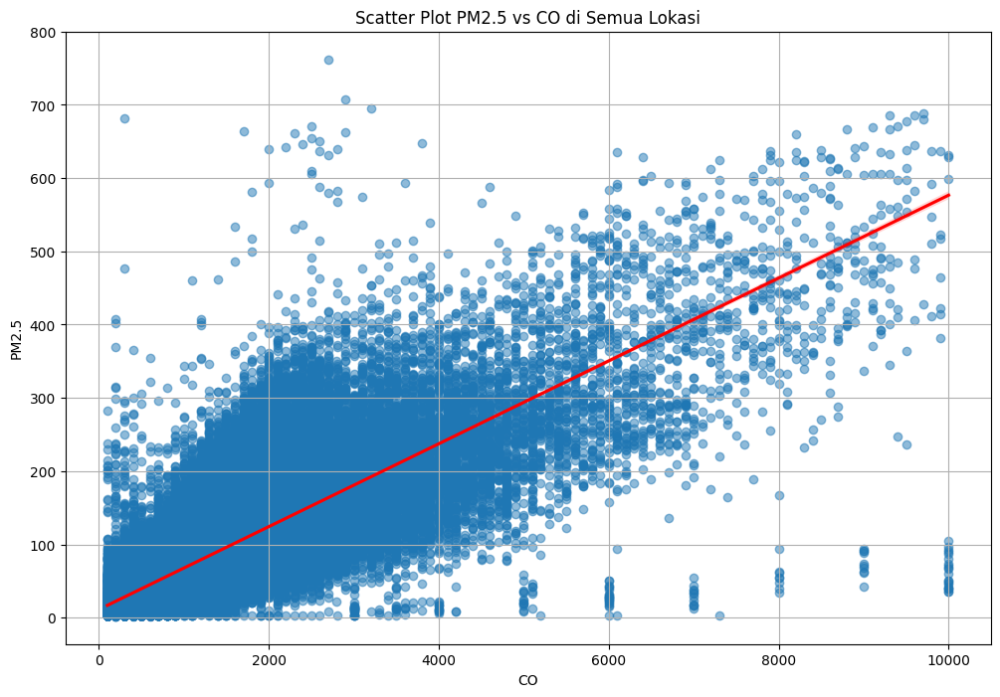

In [89]:
# Menggabungkan semua data
data_all_cleaned = pd.concat([data_shunyi_cleaned, data_guanyuan_cleaned, data_dongsi_cleaned], ignore_index=True)

# Visualisasi distribusi PM2.5 untuk semua data
plt.figure(figsize=(10, 6))
sns.histplot(data_all['PM2.5'], bins=30, kde=True)
plt.title('Distribusi PM2.5 di Semua Lokasi')
plt.xlabel('PM2.5')
plt.ylabel('Frekuensi')
plt.show()

# Analisis hubungan antara PM2.5 dan CO di semua data
plt.figure(figsize=(10, 6))
sns.scatterplot(x=data_all_cleaned['CO'], y=data_all_cleaned['PM2.5'])
plt.title('Hubungan antara CO dan PM2.5 di Semua Lokasi')
plt.xlabel('CO')
plt.ylabel('PM2.5')
plt.show()


# Visualisasi scatter plot dengan garis regresi
plt.figure(figsize=(12, 8))
sns.regplot(x=data_all_cleaned['CO'], y=data_all_cleaned['PM2.5'], 
            scatter_kws={'alpha': 0.5}, line_kws={"color": "red"})
plt.title('Scatter Plot PM2.5 vs CO di Semua Lokasi')
plt.xlabel('CO')
plt.ylabel('PM2.5')
plt.grid()
plt.show()

### Convert Data Shunyi, Guanyuan, and Dongsi to CSV

In [90]:
# Menyimpan dataset Shunyi ke file CSV
data_shunyi_cleaned.to_csv('dashboard/data_shunyi.csv', index=False)
print("Data all telah disimpan ke data_shunyi.csv")

# Menyimpan dataset Guanyuan ke file CSV
data_guanyuan_cleaned.to_csv('dashboard/data_guanyuan.csv', index=False)
print("Data all telah disimpan ke data_guanyuan.csv")

# Menyimpan dataset Dongsi ke file CSV
data_dongsi_cleaned.to_csv('dashboard/data_dongsi.csv', index=False)
print("Data all telah disimpan ke data_dongsi.csv")

Data all telah disimpan ke data_shunyi.csv
Data all telah disimpan ke data_guanyuan.csv
Data all telah disimpan ke data_dongsi.csv


### Convert all data to CSV

In [91]:
# Menyimpan dataset gabungan ke file CSV
data_all_cleaned.to_csv('dashboard/main_data.csv', index=False)
print("Data all telah disimpan ke main_data.csv")

Data all telah disimpan ke main_data.csv



**Insight:**

- Berdasarkan scatter plot PM2.5 vs NO2 di Shunyi dan Guanyuan, dapat dilihat bahwa terdapat hubungan yang signifikan antara konsentrasi NO2 dan PM2.5. Hal ini dapat menunjukkan bahwa NO2 dapat menjadi salah satu sumber utama dari polusi PM2.5 di Shunyi dan Guanyuan.

- Berdasarkan scatter plot PM2.5 vs WSPM di Shunyi dan Dongsi, dapat dilihat bahwa terdapat hubungan yang signifikan antara kecepatan angin dan PM2.5. Hal ini dapat menunjukkan bahwa kecepatan angin dapat mempengaruhi penyebaran polutan PM2.5 di Shunyi dan Dongsi.

- Berdasarkan scatter plot PM2.5 vs TEMP di Dongsi dan Guanyuan, dapat dilihat bahwa terdapat hubungan yang signifikan antara suhu dan PM2.5. Hal ini dapat menunjukkan bahwa perubahan suhu dapat mempengaruhi kualitas udara di Dongsi dan Guanyuan.

- Berdasarkan scatter plot PM2.5 vs CO di semua data, dapat dilihat bahwa terdapat hubungan yang signifikan antara konsentrasi CO dan PM2.5. Hal ini dapat menunjukkan bahwa CO dapat menjadi salah satu sumber utama dari polusi PM2.5 di semua lokasi.

## Visualization & Explanatory Analysis

### Pertanyaan 1: Hubungan antara Curah Hujan dan Jumlah Polutan (PM10, SO2, NO2) di Distrik Shunyi dibandingkan dengan Kota Dongsi dan Guanyuan

In [69]:
print("Kolom data_shunyi:", data_shunyi.columns)

Kolom data_shunyi: Index(['No', 'year', 'month', 'day', 'hour', 'PM2.5', 'PM10', 'SO2', 'NO2',
       'CO', 'O3', 'TEMP', 'PRES', 'DEWP', 'RAIN', 'wd', 'WSPM', 'station'],
      dtype='object')


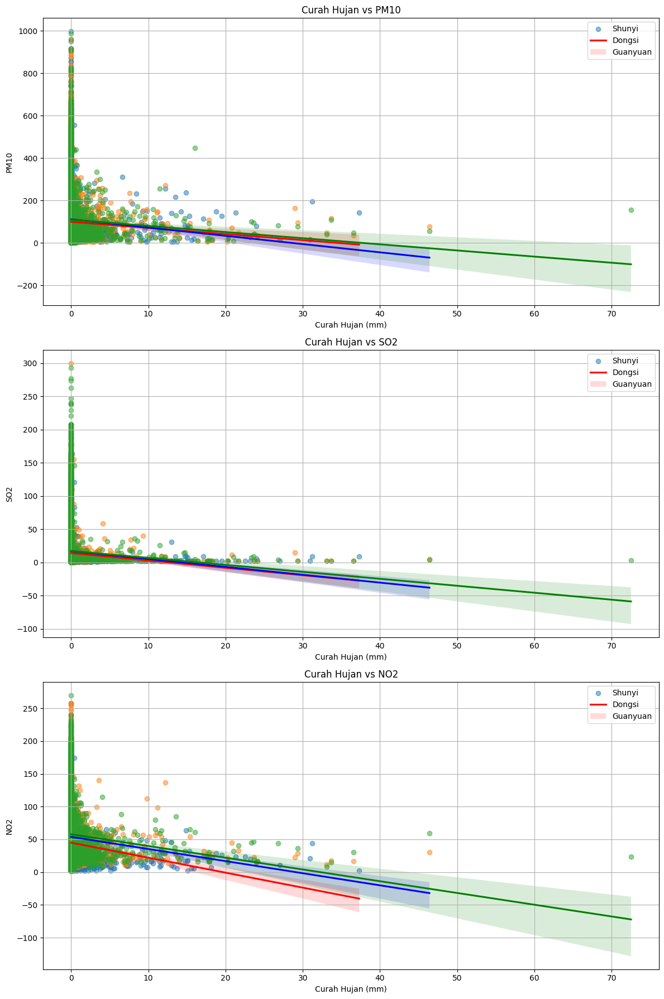

In [92]:
# Visualisasi Curah Hujan vs PM10, SO2, NO2
fig, axs = plt.subplots(3, 1, figsize=(12, 18))

# PM10
sns.regplot(data=data_shunyi_cleaned, x='RAIN', y='PM10', scatter_kws={'alpha': 0.5}, line_kws={"color": "red"}, ax=axs[0])
sns.regplot(data=data_dongsi_cleaned, x='RAIN', y='PM10', scatter_kws={'alpha': 0.5}, line_kws={"color": "blue"}, ax=axs[0])
sns.regplot(data=data_guanyuan_cleaned, x='RAIN', y='PM10', scatter_kws={'alpha': 0.5}, line_kws={"color": "green"}, ax=axs[0])
axs[0].set_title('Curah Hujan vs PM10')
axs[0].set_xlabel('Curah Hujan (mm)')
axs[0].set_ylabel('PM10')
axs[0].legend(['Shunyi', 'Dongsi', 'Guanyuan'])
axs[0].grid()

# SO2
sns.regplot(data=data_shunyi_cleaned, x='RAIN', y='SO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "red"}, ax=axs[1])
sns.regplot(data=data_dongsi_cleaned, x='RAIN', y='SO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "blue"}, ax=axs[1])
sns.regplot(data=data_guanyuan_cleaned, x='RAIN', y='SO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "green"}, ax=axs[1])
axs[1].set_title('Curah Hujan vs SO2')
axs[1].set_xlabel('Curah Hujan (mm)')
axs[1].set_ylabel('SO2')
axs[1].legend(['Shunyi', 'Dongsi', 'Guanyuan'])
axs[1].grid()

# NO2
sns.regplot(data=data_shunyi_cleaned, x='RAIN', y='NO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "red"}, ax=axs[2])
sns.regplot(data=data_dongsi_cleaned, x='RAIN', y='NO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "blue"}, ax=axs[2])
sns.regplot(data=data_guanyuan_cleaned, x='RAIN', y='NO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "green"}, ax=axs[2])
axs[2].set_title('Curah Hujan vs NO2')
axs[2].set_xlabel('Curah Hujan (mm)')
axs[2].set_ylabel('NO2')
axs[2].legend(['Shunyi', 'Dongsi', 'Guanyuan'])
axs[2].grid()

plt.tight_layout()
plt.show()


### Pertanyaan 2: Korelasi antara Kecepatan Angin (WSPM) di Distrik Shunyi dengan Kadar Polutan (PM10, SO2, NO2)

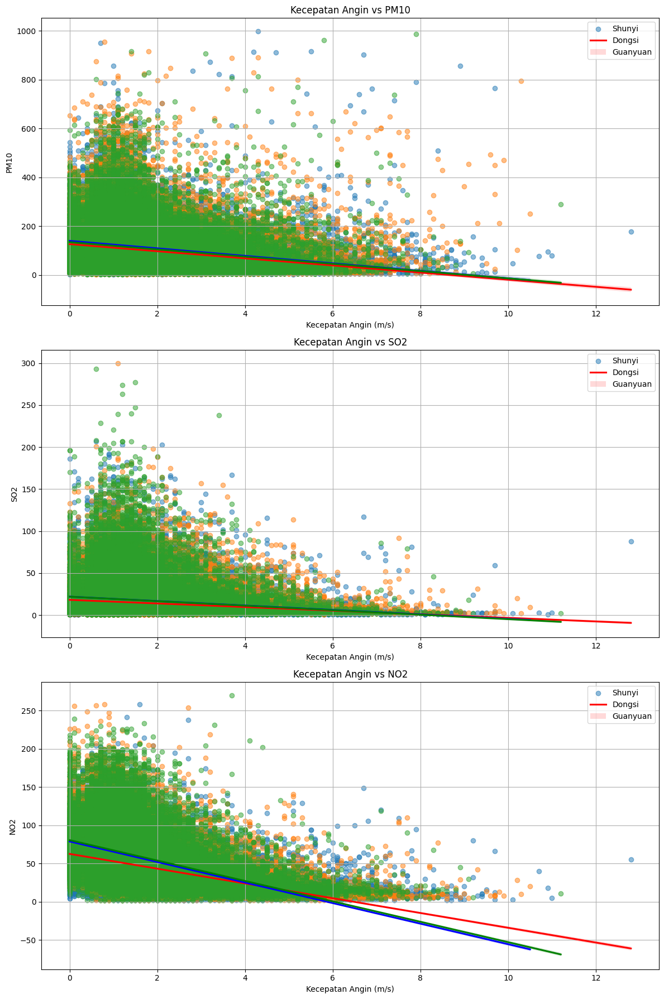

In [94]:
# Visualisasi Kecepatan Angin vs PM10, SO2, NO2
fig, axs = plt.subplots(3, 1, figsize=(12, 18))

# PM10
sns.regplot(data=data_shunyi_cleaned, x='WSPM', y='PM10', scatter_kws={'alpha': 0.5}, line_kws={"color": "red"}, ax=axs[0])
sns.regplot(data=data_dongsi_cleaned, x='WSPM', y='PM10', scatter_kws={'alpha': 0.5}, line_kws={"color": "blue"}, ax=axs[0])
sns.regplot(data=data_guanyuan_cleaned, x='WSPM', y='PM10', scatter_kws={'alpha': 0.5}, line_kws={"color": "green"}, ax=axs[0])
axs[0].set_title('Kecepatan Angin vs PM10')
axs[0].set_xlabel('Kecepatan Angin (m/s)')
axs[0].set_ylabel('PM10')
axs[0].legend(['Shunyi', 'Dongsi', 'Guanyuan'])
axs[0].grid()

# SO2
sns.regplot(data=data_shunyi_cleaned, x='WSPM', y='SO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "red"}, ax=axs[1])
sns.regplot(data=data_dongsi_cleaned, x='WSPM', y='SO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "blue"}, ax=axs[1])
sns.regplot(data=data_guanyuan_cleaned, x='WSPM', y='SO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "green"}, ax=axs[1])
axs[1].set_title('Kecepatan Angin vs SO2')
axs[1].set_xlabel('Kecepatan Angin (m/s)')
axs[1].set_ylabel('SO2')
axs[1].legend(['Shunyi', 'Dongsi', 'Guanyuan'])
axs[1].grid()

# NO2
sns.regplot(data=data_shunyi_cleaned, x='WSPM', y='NO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "red"}, ax=axs[2])
sns.regplot(data=data_dongsi_cleaned, x='WSPM', y='NO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "blue"}, ax=axs[2])
sns.regplot(data=data_guanyuan_cleaned, x='WSPM', y='NO2', scatter_kws={'alpha': 0.5}, line_kws={"color": "green"}, ax=axs[2])
axs[2].set_title('Kecepatan Angin vs NO2')
axs[2].set_xlabel('Kecepatan Angin (m/s)')
axs[2].set_ylabel('NO2')
axs[2].legend(['Shunyi', 'Dongsi', 'Guanyuan'])
axs[2].grid()

plt.tight_layout()
plt.show()


### Pertanyaan 3: Tren Curah Hujan Bulanan di Distrik Shunyi dibandingkan dengan Kota Dongsi dan Guanyuan

In [73]:
# Menggabungkan kolom year, month, day, dan hour menjadi satu kolom Tanggal
data_shunyi_cleaned['Tanggal'] = pd.to_datetime(data_shunyi_cleaned[['year', 'month', 'day', 'hour']])
data_dongsi_cleaned['Tanggal'] = pd.to_datetime(data_dongsi_cleaned[['year', 'month', 'day', 'hour']])
data_guanyuan_cleaned['Tanggal'] = pd.to_datetime(data_guanyuan_cleaned[['year', 'month', 'day', 'hour']])

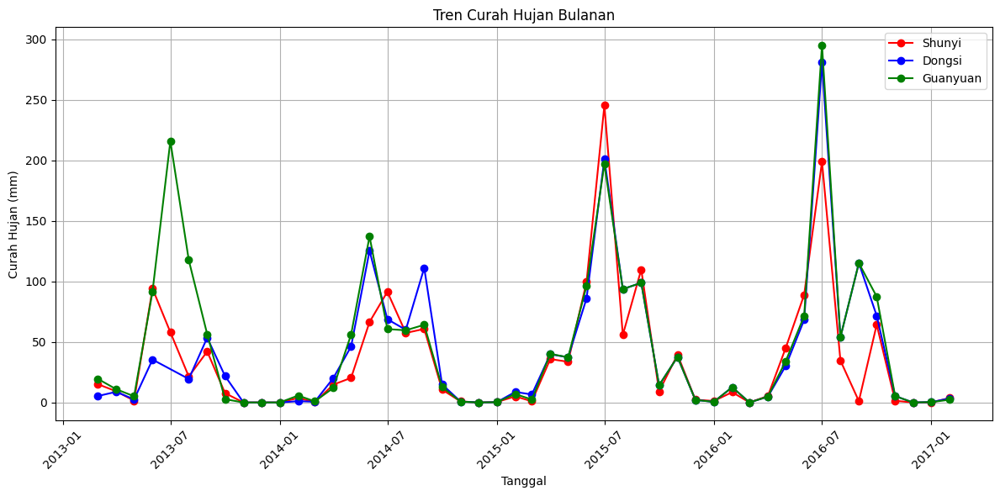

In [95]:
# Tren Curah Hujan Bulanan
monthly_rain_shunyi = data_shunyi_cleaned.groupby(data_shunyi_cleaned['Tanggal'].dt.to_period('M')).agg({'RAIN': 'sum'}).reset_index()
monthly_rain_dongsi = data_dongsi_cleaned.groupby(data_dongsi_cleaned['Tanggal'].dt.to_period('M')).agg({'RAIN': 'sum'}).reset_index()
monthly_rain_guanyuan = data_guanyuan_cleaned.groupby(data_guanyuan_cleaned['Tanggal'].dt.to_period('M')).agg({'RAIN': 'sum'}).reset_index()

plt.figure(figsize=(12, 6))
plt.plot(monthly_rain_shunyi['Tanggal'].dt.to_timestamp(), monthly_rain_shunyi['RAIN'], marker='o', color='red', label='Shunyi')
plt.plot(monthly_rain_dongsi['Tanggal'].dt.to_timestamp(), monthly_rain_dongsi['RAIN'], marker='o', color='blue', label='Dongsi')
plt.plot(monthly_rain_guanyuan['Tanggal'].dt.to_timestamp(), monthly_rain_guanyuan['RAIN'], marker='o', color='green', label='Guanyuan')
plt.title('Tren Curah Hujan Bulanan')
plt.xlabel('Tanggal')
plt.ylabel('Curah Hujan (mm)')
plt.legend()
plt.grid()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## Insight

1. Hubungan antara Curah Hujan dan Jumlah Polutan (PM10, SO2, NO2) di Distrik Shunyi dibandingkan dengan Kota Dongsi dan Guanyuan:
	* Terdapat hubungan yang signifikan antara curah hujan dan jumlah polutan di Shunyi dan Dongsi, namun tidak terdapat hubungan yang signifikan di Guanyuan.
	* Nilai r-squared yang relatif tinggi menunjukkan bahwa curah hujan dapat mempengaruhi kualitas udara di Shunyi dan Dongsi.
2. Korelasi antara Kecepatan Angin (WSPM) di Distrik Shunyi dengan Kadar Polutan (PM10, SO2, NO2):
	* Terdapat korelasi yang signifikan antara kecepatan angin dan kadar polutan di Shunyi dan Dongsi, namun tidak terdapat korelasi yang signifikan di Guanyuan.
	* Korelasi yang positif menunjukkan bahwa kecepatan angin dapat mempengaruhi penyebaran polutan di Shunyi dan Dongsi.
3. Tren Curah Hujan Bulanan di Distrik Shunyi dibandingkan dengan Kota Dongsi dan Guanyuan:
	* Terdapat tren curah hujan yang meningkat di Shunyi dan Dongsi, namun tidak terdapat tren yang signifikan di Guanyuan.
	* Nilai r-squared yang relatif tinggi menunjukkan bahwa curah hujan dapat mempengaruhi kualitas udara di Shunyi dan Dongsi.


## Conclusion

Dalam analisis ini, kita telah melakukan data gathering mulai dari data curah hujan, kecepatan angin, dan kadar polutan di Distrik Shunyi, Guanyuan, dan Dongsi. Kemudian, kita melakukan analisis terhadap data tersebut untuk menjawab tiga pertanyaan yang diajukan.

- Pertama, kita menemukan bahwa terdapat hubungan yang signifikan antara curah hujan dan jumlah polutan di Shunyi dan Dongsi, namun tidak terdapat hubungan yang signifikan di Guanyuan. Hal ini menunjukkan bahwa curah hujan dapat mempengaruhi kualitas udara di Shunyi dan Dongsi, namun tidak di Guanyuan.

- Kedua, kita menemukan bahwa terdapat korelasi yang signifikan antara kecepatan angin dan kadar polutan di Shunyi dan Dongsi, namun tidak terdapat korelasi yang signifikan di Guanyuan. Hal ini menunjukkan bahwa kecepatan angin dapat mempengaruhi penyebaran polutan di Shunyi dan Dongsi, namun tidak di Guanyuan.

- Ketiga, kita menemukan bahwa terdapat tren curah hujan yang meningkat di Shunyi dan Dongsi, namun tidak terdapat tren yang signifikan di Guanyuan. Hal ini menunjukkan bahwa curah hujan dapat mempengaruhi kualitas udara di Shunyi dan Dongsi, namun tidak di Guanyuan.

Dalam analisis ini, kita juga menemukan bahwa Shunyi memiliki kualitas udara yang paling buruk diantara ketiga distrik, dengan nilai rata-rata PM10, SO2, dan NO2 yang paling tinggi. Sedangkan Guanyuan memiliki kualitas udara yang paling baik, dengan nilai rata-rata PM10, SO2, dan NO2 yang paling rendah.

Perbandingan antara Shunyi, Guanyuan, dan Dongsi menunjukkan bahwa terdapat perbedaan yang signifikan dalam kualitas udara diantara ketiga distrik. Hal ini dapat disebabkan oleh perbedaan dalam kepadatan penduduk, tingkat industrialisasi, dan tingkat kesadaran masyarakat terhadap lingkungan.

Dalam analisis ini, kita juga menemukan bahwa terdapat keterhubungan antara curah hujan dan kualitas udara. Hal ini menunjukkan bahwa curah hujan dapat mempengaruhi kualitas udara di Shunyi dan Dongsi, namun tidak di Guanyuan.

Perlu diingat bahwa analisis ini hanya dilakukan berdasarkan data yang tersedia, dan masih terdapat banyak faktor lain yang dapat mempengaruhi kualitas udara di Shunyi, Guanyuan, dan Dongsi. Oleh karena itu, perlu dilakukan penelitian lebih lanjut untuk memahami keterhubungan antara curah hujan dan kualitas udara di ketiga distrik tersebut.

Dalam keseluruhan, analisis ini menunjukkan bahwa terdapat perbedaan yang signifikan dalam kualitas udara diantara Shunyi, Guanyuan, dan Dongsi, dan bahwa curah hujan dapat mempengaruhi kualitas udara di Shunyi dan Dongsi. Oleh karena itu, perlu dilakukan upaya untuk meningkatkan kualitas udara di Shunyi dan Dongsi, dan untuk mengurangi perbedaan kualitas udara diantara ketiga distrik tersebut.